## Combined Dataset SOC Prediction - Convolutional Neural Net (DNN)
Uses discharge cycles from both the LG and Panasonic datasets.

LG 18650HG2 Li-ion Battery Data - https://data.mendeley.com/datasets/cp3473x7xv/3

Panasonic 18650PF Li-ion Battery Data - https://data.mendeley.com/datasets/wykht8y7tg/1

Kollmeyer, Philip; Vidal, Carlos; Naguib, Mina; Skells, Michael  (2020), “LG 18650HG2 Li-ion Battery Data and Example Deep Neural Network xEV SOC Estimator Script”, Mendeley Data, V3, doi: 10.17632/cp3473x7xv.3

Kollmeyer, Phillip (2018), “Panasonic 18650PF Li-ion Battery Data”, Mendeley Data, V1, doi: 10.17632/wykht8y7tg.1

In [12]:
import os
import sys
import IPython
import IPython.display
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import collections
from numpy import reshape, array
from datetime import datetime, timedelta

import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Conv1D
from keras.layers.core import Dense
from tensorflow.keras import layers


cell_type = "comb"
model_type = "cnn_model"
base_path = '../../'

sys.path.append(base_path)
from training import utils

panasonic_data_path = base_path + 'datasets/Panasonic_18650PF'
lg_data_path = base_path + 'datasets/LG_18650HG2'
pre_trained_path = base_path + 'pre-trained/' + cell_type + '_' + model_type

resample_1hz = True
vi_averages = True

## Panasonic Test, Train Processing

In [2]:
panasonic_test_temps = ['n10degC', '0degC', '10degC', '25degC']
panasonic_test_discharge_cycles = ['US06', 'LA92', 'NN']

panasonic_train_temps = ['n10degC', '0degC', '10degC', '25degC']
panasonic_train_discharge_cycles = ['UDDS', 'HWFET', 'HWFT']

panasonic_train_files = utils.panasonic_get_files(panasonic_data_path,
                                                  panasonic_train_discharge_cycles, 
                                                  panasonic_train_temps)

panasonic_test_files = utils.panasonic_get_files(panasonic_data_path, 
                                                 panasonic_test_discharge_cycles,
                                                 panasonic_test_temps)

for file in panasonic_train_files:
    if "UDDS_LA92" in file or "LA92_NN" in file:
        panasonic_train_files.remove(file)

for file in panasonic_test_files:
    if "UDDS_LA92" in file or "LA92_NN" in file:
        panasonic_test_files.remove(file)

panasonic_train, panasonic_train_norm = utils.panasonic_create_dataset(panasonic_train_files,
                                                                       panasonic_train_discharge_cycles, 
                                                                       vi_averages, 
                                                                       resample_1hz)

panasonic_test, panasonic_test_norm = utils.panasonic_create_dataset(panasonic_test_files, 
                                                                     panasonic_test_discharge_cycles, 
                                                                     vi_averages, 
                                                                     resample_1hz)

../../datasets/Panasonic_18650PF/0degC/Drive cycles/06-02-17_10.43 0degC_HWFET_Pan18650PF.csv 59854
../../datasets/Panasonic_18650PF/0degC/Drive cycles/06-02-17_17.14 0degC_UDDS_Pan18650PF.csv 128522
../../datasets/Panasonic_18650PF/10degC/Drive Cycles/03-27-17_09.06 10degC_HWFET_Pan18650PF.csv 70406
../../datasets/Panasonic_18650PF/10degC/Drive Cycles/03-27-17_09.06 10degC_UDDS_Pan18650PF.csv 210465
../../datasets/Panasonic_18650PF/25degC/Drive cycles/03-20-17_05.56 25degC_HWFTa_Pan18650PF.csv 75955
../../datasets/Panasonic_18650PF/25degC/Drive cycles/03-20-17_19.27 25degC_HWFTb_Pan18650PF.csv 75811
../../datasets/Panasonic_18650PF/25degC/Drive cycles/03-21-17_00.29 25degC_UDDS_Pan18650PF.csv 224187
../../datasets/Panasonic_18650PF/n10degC/Drive Cycles/06-07-17_08.39 n10degC_HWFET_Pan18650PF.csv 51385
../../datasets/Panasonic_18650PF/n10degC/Drive Cycles/06-07-17_08.39 n10degC_UDDS_Pan18650PF.csv 109717
../../datasets/Panasonic_18650PF/0degC/Drive cycles/06-01-17_10.36 0degC_LA92_Pan1

## LG Test, Train Processing

In [3]:
lg_charge_cycles = ['Charge']

lg_test_temps = ['n10degC', '0degC', '10degC', '25degC']
lg_test_discharge_cycles = ['Mixed1', 'Mixed2', 'Mixed3', 'Mixed4', 'LA92', 'US06']

lg_train_temps = ['n10degC', '0degC', '10degC', '25degC']
lg_train_discharge_cycles = ['Mixed5', 'Mixed6', 'Mixed7', 'Mixed8', 'UDDS', 'HWFET']

lg_train_files = utils.lg_get_files(lg_data_path, 
                                    lg_train_discharge_cycles, 
                                    lg_charge_cycles, 
                                    lg_train_temps)

lg_test_files = utils.lg_get_files(lg_data_path, 
                                   lg_test_discharge_cycles,
                                   lg_charge_cycles, 
                                   lg_test_temps)

lg_train, lg_train_norm = utils.lg_create_dataset(lg_train_files, 
                                                  lg_train_discharge_cycles, 
                                                  lg_charge_cycles, 
                                                  vi_averages, 
                                                  resample_1hz)

lg_test, lg_test_norm = utils.lg_create_dataset(lg_test_files, 
                                                lg_test_discharge_cycles, 
                                                lg_charge_cycles, 
                                                vi_averages, 
                                                resample_1hz)

../../datasets/LG_18650HG2/25degC/551_UDDS.csv 159646
../../datasets/LG_18650HG2/25degC/551_HWFET.csv 6002
../../datasets/LG_18650HG2/25degC/552_Mixed5.csv 72184
../../datasets/LG_18650HG2/25degC/552_Mixed6.csv 78106
../../datasets/LG_18650HG2/25degC/552_Mixed7.csv 73235
../../datasets/LG_18650HG2/25degC/552_Mixed8.csv 85915
../../datasets/LG_18650HG2/10degC/571_Mixed5.csv 67174
../../datasets/LG_18650HG2/10degC/571_Mixed6.csv 73921
../../datasets/LG_18650HG2/10degC/571_Mixed7.csv 69325
../../datasets/LG_18650HG2/10degC/571_Mixed8.csv 81422
../../datasets/LG_18650HG2/10degC/576_UDDS.csv 148898
../../datasets/LG_18650HG2/10degC/576_HWFET.csv 52878
../../datasets/LG_18650HG2/0degC/589_UDDS.csv 140435
../../datasets/LG_18650HG2/0degC/589_HWFET.csv 49678
../../datasets/LG_18650HG2/0degC/590_Mixed5.csv 64995
../../datasets/LG_18650HG2/0degC/590_Mixed6.csv 62483
../../datasets/LG_18650HG2/0degC/590_Mixed7.csv 61540
../../datasets/LG_18650HG2/0degC/590_Mixed8.csv 75838
../../datasets/LG_18650

## Panasonic, LG Train Test Stats

In [5]:
panasonic_test.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Voltage,86137.0,3.607147,0.258449,2.492400,3.435570,3.606060,3.797790,4.214870
Current,86137.0,-1.069468,2.368708,-20.484090,-2.044820,-0.278470,-0.000820,9.657050
Temperature,86137.0,13.479079,11.563432,-8.124518,3.494127,12.690260,26.460110,32.770330
Power,86137.0,-3.560242,8.096008,-53.488989,-7.269278,-1.000200,-0.003115,35.042827
Capacity,86137.0,0.464514,0.280495,0.000000,0.221123,0.467619,0.708228,0.963880
Voltage Average,86137.0,3.627756,0.226462,3.038145,3.458828,3.622753,3.802566,4.101948
Current Average,86137.0,-1.106134,0.568743,-2.986729,-1.332306,-0.888142,-0.748530,-0.242808
Power Average,86137.0,-3.706243,1.849461,-9.172898,-4.301810,-2.999961,-2.615629,-0.702527


In [6]:
panasonic_train.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Voltage,96547.0,3.627809,0.247314,2.498190,3.458090,3.624720,3.815960,4.200710
Current,96547.0,-0.772951,1.119336,-7.437770,-1.506660,-0.620630,-0.071050,5.511660
Temperature,96547.0,12.290873,12.484846,-9.262373,1.796085,11.416263,26.045400,29.822570
Power,96547.0,-2.712749,3.963937,-18.927653,-5.428331,-2.280660,-0.276703,19.280503
Capacity,96547.0,0.481228,0.283894,0.000000,0.238972,0.492247,0.725709,0.968880
Voltage Average,96547.0,3.643568,0.235658,3.021374,3.470979,3.639031,3.828227,4.110933
Current Average,96547.0,-0.793547,0.440024,-1.926452,-1.236214,-0.620933,-0.405029,-0.192152
Power Average,96547.0,-2.798013,1.535319,-5.868891,-4.371582,-2.199998,-1.425870,-0.527066


In [7]:
lg_test.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Time Stamp,,,,,,,,
Voltage,123526.0,3.656889,0.269292,2.792680,3.484780,3.663520,3.855950,4.199950
Current,123526.0,-1.399379,2.783005,-17.610450,-2.750750,-0.891380,-0.079180,5.999610
Temperature,123526.0,8.113620,12.667327,-9.884900,-0.315480,9.464270,23.976150,26.815430
Power,123526.0,-4.783771,9.687384,-50.864924,-9.769781,-3.278140,-0.288570,25.170201
Capacity,123526.0,0.485218,0.269210,0.000000,0.268628,0.474954,0.706504,0.978056
Voltage Average,123526.0,3.693178,0.230521,3.089037,3.516467,3.687100,3.881051,4.139058
Current Average,123526.0,-1.362505,0.752499,-3.810095,-1.780143,-1.186816,-0.810741,-0.281791
Power Average,123526.0,-4.725911,2.527213,-11.887300,-6.361468,-4.187582,-2.800867,-1.101802


In [8]:
lg_train.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Time Stamp,,,,,,,,
Voltage,157293.0,3.680043,0.255552,2.795040,3.503950,3.689920,3.881540,4.200630
Current,157293.0,-1.126052,2.225553,-17.822440,-2.229720,-0.771340,-0.097060,5.999610
Temperature,157293.0,7.073187,12.102291,-10.095220,-0.420630,9.148790,23.765830,26.289630
Power,157293.0,-3.904234,7.811431,-50.862673,-8.078228,-2.841708,-0.386795,25.171220
Capacity,157293.0,0.485286,0.266660,0.000000,0.258414,0.484778,0.718939,0.955909
Voltage Average,157293.0,3.708117,0.225104,3.049658,3.524823,3.717509,3.902649,4.110299
Current Average,157293.0,-1.112342,0.681869,-3.715850,-1.460238,-0.934615,-0.519147,-0.277316
Power Average,157293.0,-3.898731,2.313701,-11.429077,-4.973225,-3.264910,-1.868971,-1.079428


## Merge Panasonic and LG datasets

In [4]:
merged_train = pd.concat([lg_train, panasonic_train], ignore_index=True)
merged_test = pd.concat([lg_test, panasonic_test], ignore_index=True)

#merged_train_norm = utils.normalization(merged_train, minmax_norm=True)
#merged_test_norm = utils.normalization(merged_test, minmax_norm=True)
merged_train_norm = pd.concat([lg_train_norm, panasonic_train_norm], ignore_index=True)
merged_test_norm = pd.concat([lg_test_norm, panasonic_test_norm], ignore_index=True)

In [8]:
merged_train.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Voltage,253840.0,3.660176,0.253720,2.498190,3.484780,3.665100,3.856250,4.200710
Current,253840.0,-0.991751,1.890798,-17.822440,-1.855360,-0.694130,-0.074310,5.999610
Temperature,253840.0,9.057712,12.508344,-10.095220,-0.210320,9.464270,23.976150,29.822570
Power,253840.0,-3.451057,6.642370,-50.862673,-6.607739,-2.529612,-0.278277,25.171220
Capacity,253840.0,0.483743,0.273349,0.000000,0.251470,0.487365,0.721492,0.968880
Voltage Average,253840.0,3.683566,0.231308,3.021374,3.508424,3.685106,3.877800,4.110933
Current Average,253840.0,-0.991090,0.621047,-3.715850,-1.338842,-0.840799,-0.492678,-0.192152
Power Average,253840.0,-3.480077,2.121139,-11.429077,-4.672355,-3.011715,-1.760591,-0.527066


In [9]:
merged_test.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Voltage,209663.0,3.636454,0.266018,2.492400,3.461310,3.641370,3.831400,4.214870
Current,209663.0,-1.263840,2.625751,-20.484090,-2.477470,-0.589990,-0.011430,9.657050
Temperature,209663.0,10.317941,12.507580,-9.884900,0.105160,9.884900,24.081300,32.770330
Power,209663.0,-4.281102,9.087394,-53.488989,-8.871215,-2.162196,-0.043212,35.042827
Capacity,209663.0,0.476712,0.274091,0.000000,0.251692,0.472652,0.707331,0.978056
Voltage Average,209663.0,3.666300,0.231114,3.038145,3.494658,3.662566,3.845631,4.139058
Current Average,209663.0,-1.257178,0.694562,-3.810095,-1.505179,-1.086713,-0.767024,-0.242808
Power Average,209663.0,-4.306995,2.328044,-11.887300,-4.946934,-3.826823,-2.668705,-0.702527


## Merged Dataset Figures, Distribution

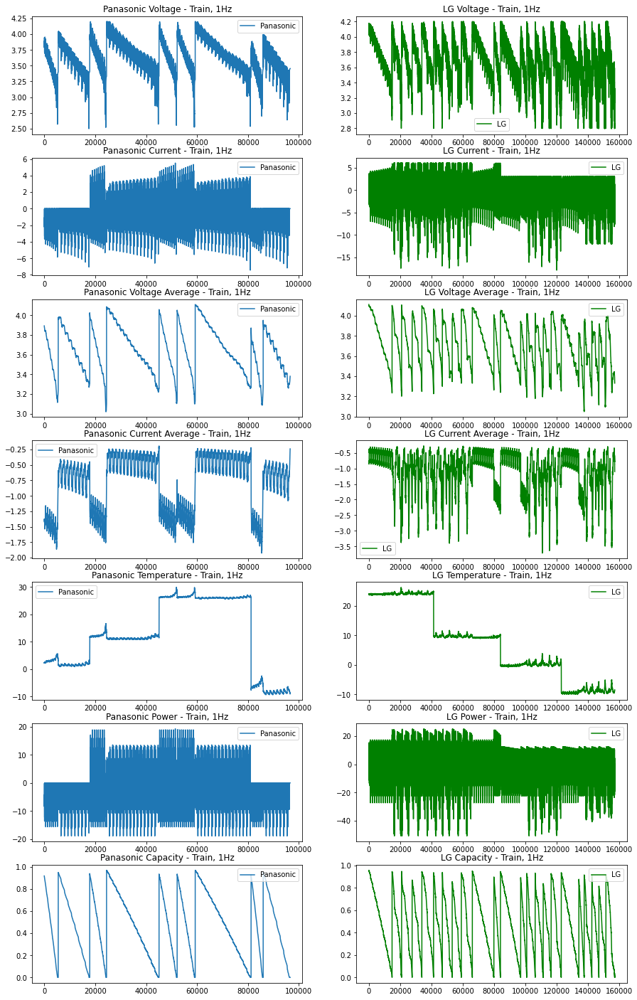

In [16]:
plot_cols = ['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Power', 'Capacity']

fig, axs = plt.subplots(nrows=len(plot_cols), ncols=2, figsize=(15, 25))

for i, col in enumerate(plot_cols):
    axs[i, 0].plot(panasonic_train[col], label='Panasonic')
    axs[i, 0].set_title(f'Panasonic {col} - Train, 1Hz')
    axs[i, 0].legend()
    
    axs[i, 1].plot(lg_train[col], label='LG', color="green")
    axs[i, 1].set_title(f'LG {col} - Train, 1Hz')
    axs[i, 1].legend()

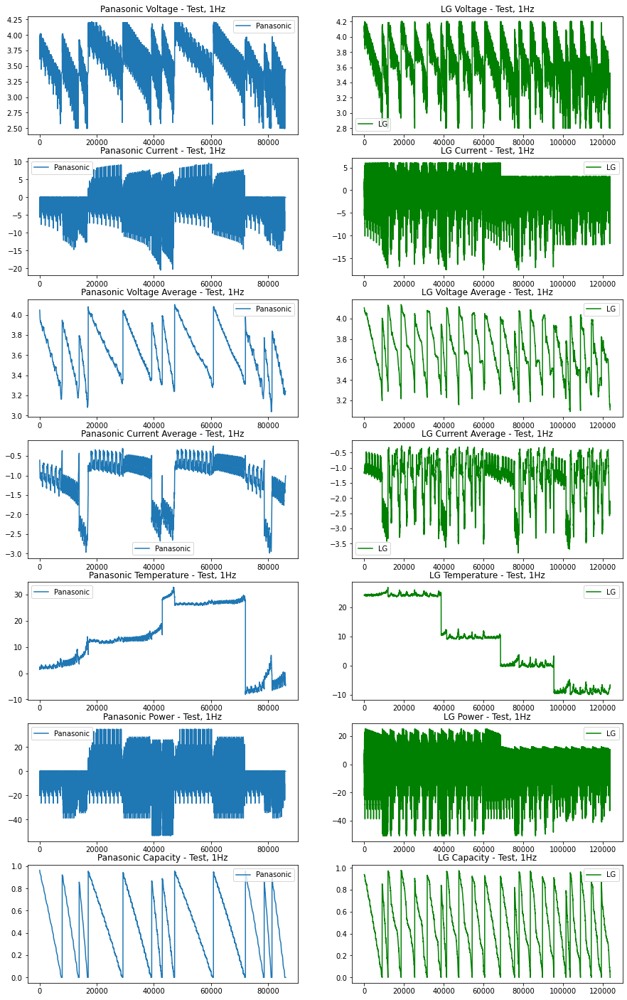

In [17]:
plot_cols = ['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Power', 'Capacity']

fig, axs = plt.subplots(nrows=len(plot_cols), ncols=2, figsize=(15, 25))

for i, col in enumerate(plot_cols):
    axs[i, 0].plot(panasonic_test[col], label='Panasonic')
    axs[i, 0].set_title(f'Panasonic {col} - Test, 1Hz')
    axs[i, 0].legend()
    
    axs[i, 1].plot(lg_test[col], label='LG', color="green")
    axs[i, 1].set_title(f'LG {col} - Test, 1Hz')
    axs[i, 1].legend()

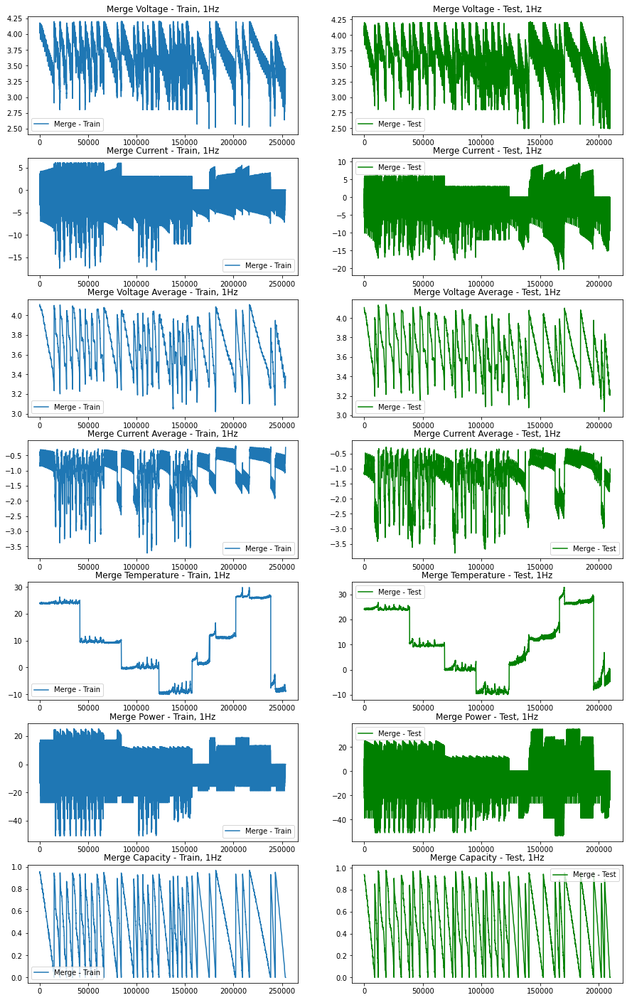

In [18]:
plot_cols = ['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Power', 'Capacity']

fig, axs = plt.subplots(nrows=len(plot_cols), ncols=2, figsize=(15, 25))

for i, col in enumerate(plot_cols):
    axs[i, 0].plot(merged_train[col], label='Merge - Train')
    axs[i, 0].set_title(f'Merge {col} - Train, 1Hz')
    axs[i, 0].legend()
    
    axs[i, 1].plot(merged_test[col], label='Merge - Test', color="green")
    axs[i, 1].set_title(f'Merge {col} - Test, 1Hz')
    axs[i, 1].legend()

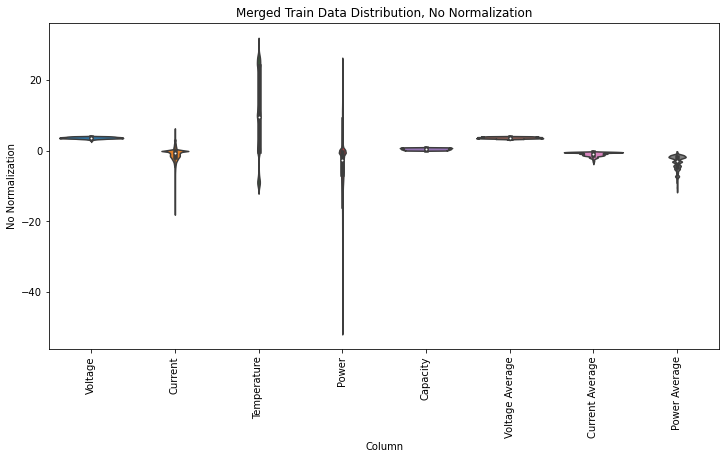

In [19]:
df_std = merged_train.melt(var_name='Column', value_name='No Normalization')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='No Normalization', data=df_std)
_ = ax.set_xticklabels(merged_train.keys(), rotation=90)
_ = ax.set_title(label='Merged Train Data Distribution, No Normalization')

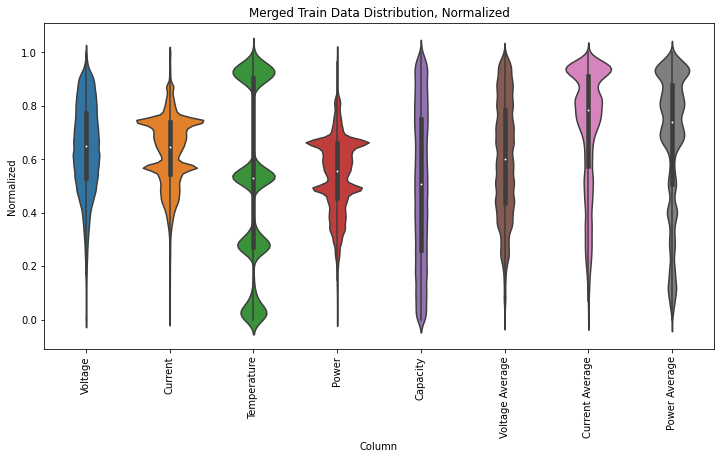

In [20]:
df_std = merged_train_norm.melt(var_name='Column', value_name='Normalized')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='Normalized', data=df_std)
_ = ax.set_xticklabels(merged_train_norm.keys(), rotation=90)
_ = ax.set_title(label='Merged Train Data Distribution, Normalized')

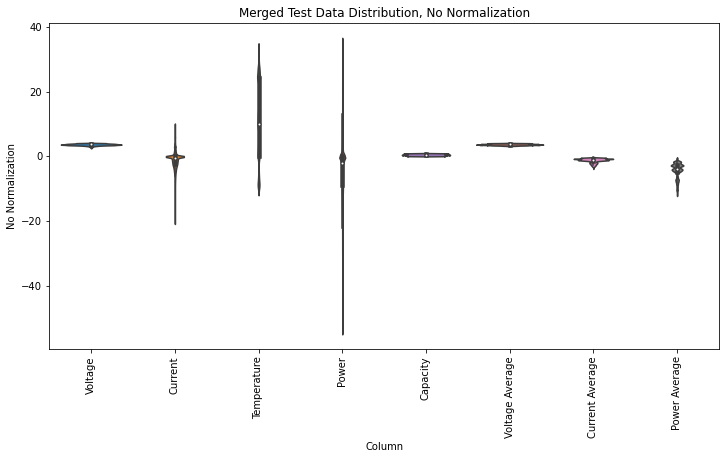

In [21]:
df_std = merged_test.melt(var_name='Column', value_name='No Normalization')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='No Normalization', data=df_std)
_ = ax.set_xticklabels(merged_test.keys(), rotation=90)
_ = ax.set_title(label='Merged Test Data Distribution, No Normalization')

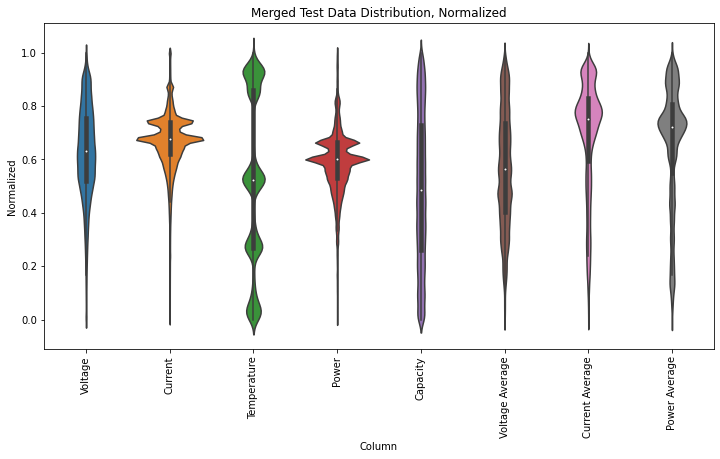

In [22]:
df_std = merged_test_norm.melt(var_name='Column', value_name='Normalized')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='Normalized', data=df_std)
_ = ax.set_xticklabels(merged_test_norm.keys(), rotation=90)
_ = ax.set_title(label='Merged Test Data Distribution, Normalized')

Text(0.5, 1.01, 'Pair Plot, Merged Training Dataset')

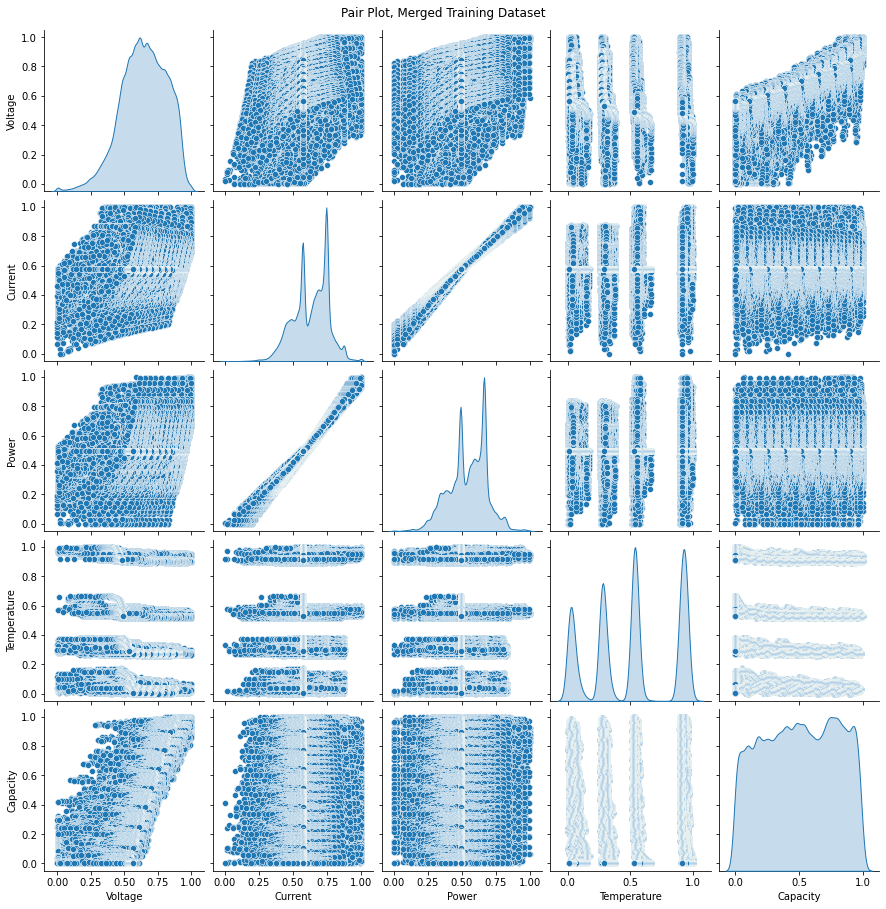

In [23]:
ax = sns.pairplot(merged_train_norm[['Voltage', 'Current', 'Power', 'Temperature', 'Capacity']], diag_kind='kde')
ax.fig.suptitle("Pair Plot, Merged Training Dataset", y = 1.01) 

## CNN MODEL TRAINING

In [13]:
train_features = merged_train_norm[['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Capacity']].copy()
test_features = merged_test_norm[['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Capacity']].copy()

train_labels = train_features.pop('Capacity')
test_labels = test_features.pop('Capacity')

In [14]:
# reshape for CNN 1-D
train_array = array(train_features)
labels_array = array(train_labels)

sample_size = train_features.shape[0]
time_steps = train_features.shape[1]
input_dimension = 1

train_reshaped = train_array.reshape((sample_size,time_steps,1))
labels_reshaped = labels_array.reshape((train_labels.shape[0],1,1))

print(train_reshaped.shape)
print(labels_reshaped.shape)

(253840, 5, 1)
(253840, 1, 1)


In [15]:
# cnn model definition
cnn_model = Sequential()
cnn_model.add(Conv1D(filters=32,
                     kernel_size=(train_features.shape[1],),
                     activation='relu'))
cnn_model.add(Dense(32, activation='relu'))
cnn_model.add(Dense(1))

cnn_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='mean_absolute_error')

2023-03-23 23:51:16.203389: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-03-23 23:51:16.230731: W tensorflow/stream_executor/cuda/cuda_driver.cc:263] failed call to cuInit: UNKNOWN ERROR (303)
2023-03-23 23:51:16.234828: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (AP-Surface): /proc/driver/nvidia/version does not exist
2023-03-23 23:51:16.267553: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [16]:
%%time
history = cnn_model.fit(
    train_reshaped, 
    train_labels,             
    epochs=25, batch_size=32, 
    verbose=1, validation_split=0.2)

Epoch 1/25
6346/6346 [==============================] - 37s 4ms/step - loss: 0.0184 - val_loss: 0.0255
Epoch 2/25
6346/6346 [==============================] - 24s 4ms/step - loss: 0.0111 - val_loss: 0.0228
Epoch 3/25
6346/6346 [==============================] - 24s 4ms/step - loss: 0.0104 - val_loss: 0.0236
Epoch 4/25
6346/6346 [==============================] - 31s 5ms/step - loss: 0.0100 - val_loss: 0.0259
Epoch 5/25
6346/6346 [==============================] - 21s 3ms/step - loss: 0.0096 - val_loss: 0.0288
Epoch 6/25
6346/6346 [==============================] - 23s 4ms/step - loss: 0.0091 - val_loss: 0.0272
Epoch 7/25
6346/6346 [==============================] - 26s 4ms/step - loss: 0.0085 - val_loss: 0.0257
Epoch 8/25
6346/6346 [==============================] - 32s 5ms/step - loss: 0.0084 - val_loss: 0.0255
Epoch 9/25
6346/6346 [==============================] - 32s 5ms/step - loss: 0.0082 - val_loss: 0.0256
Epoch 10/25
6346/6346 [==============================] - 33s 5ms/step - l

## SAVE MODEL, EVALUATE

In [17]:
cnn_model.save(pre_trained_path)

# load pre-trained model
# model = tf.keras.models.load_model(pre_trained_path)

INFO:tensorflow:Assets written to: ../../pre-trained/comb_cnn_model/assets


INFO:tensorflow:Assets written to: ../../pre-trained/comb_cnn_model/assets


In [18]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,val_loss,epoch
20,0.006985,0.024689,20
21,0.006967,0.025254,21
22,0.006857,0.025171,22
23,0.006795,0.026188,23
24,0.006770,0.024137,24


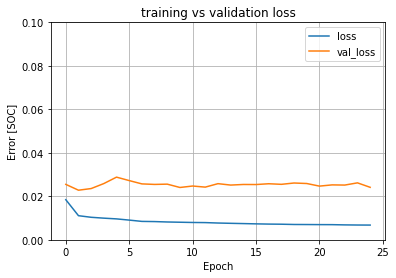

In [19]:
def plot_loss(history):
    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.ylim([0, 0.1])
    plt.xlabel('Epoch') 
    plt.ylabel('Error [SOC]')
    plt.title('training vs validation loss')
    plt.legend()
    plt.grid(True)
    
plot_loss(history)

6552/6552 - 17s - loss: 0.0327 - 17s/epoch - 3ms/step
6552/6552 [==============================] - 25s 4ms/step


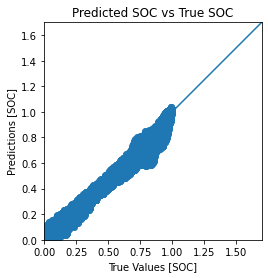

In [20]:
test_results = cnn_model.evaluate(test_features, test_labels, verbose=2)
test_predictions = cnn_model.predict(test_features).flatten()

a = plt.axes(aspect='equal')
plt.scatter(test_labels, test_predictions)
plt.xlabel('True Values [SOC]')
plt.ylabel('Predictions [SOC]')
lims = [0, 1.7]
plt.xlim(lims)
plt.ylim(lims)
plt.title('Predicted SOC vs True SOC')
_ = plt.plot(lims, lims)

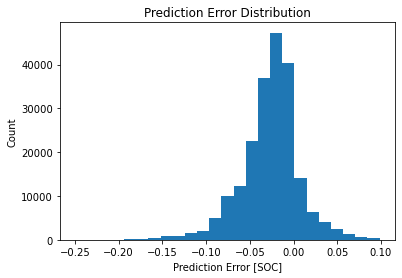

In [21]:
error = test_predictions - test_labels
plt.hist(error, bins=25)
plt.xlabel('Prediction Error [SOC]')
plt.title('Prediction Error Distribution')
_ = plt.ylabel('Count')

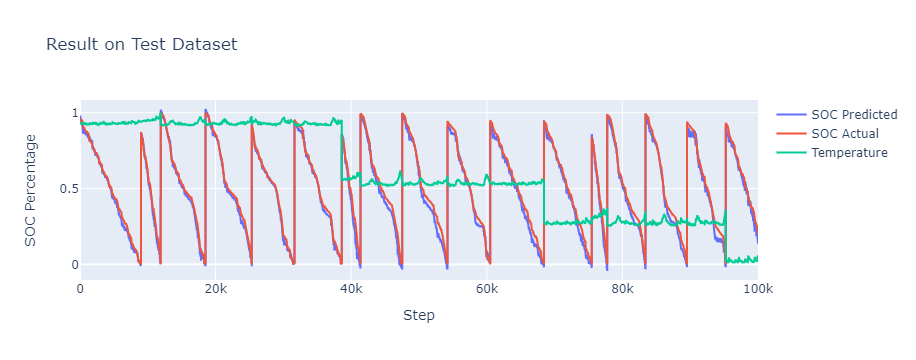

In [22]:
import plotly.graph_objects as go

cycle_num = 0
steps_num = 100000
step_index = np.arange(cycle_num*steps_num, (cycle_num+1)*steps_num)

fig = go.Figure()
fig.add_trace(go.Scatter(x=step_index, y=test_predictions[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Predicted'))
fig.add_trace(go.Scatter(x=step_index, y=test_labels[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Actual'))
fig.add_trace(go.Scatter(x=step_index, y=lg_test_norm['Temperature'][cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='Temperature'))
fig.update_layout(title='Result on Test Dataset',
                  xaxis_title='Step',
                  yaxis_title='SOC Percentage')
fig.show()